In [9]:
import os
from glob import glob
import nibabel as nib
import numpy as np
from nilearn import plotting
import shutil
from pprint import pprint
import json
import matplotlib.pyplot as plt
%matplotlib inline

In [66]:
!ls ./data/raw/anat_session_nifti/

08950.3f_181009_075018	26153.41_181005_125716	29121.94_181024_151219
11774.93_181016_074820	26824.0f_181026_111138	29997.cc_181012_081351
15484.08_181019_114712	26851.0a_181011_122104	32296.36_181022_140652
19417.87_181011_110107	26911.3b_181015_110850	32389.13_181024_074714
19717.75_181008_074232	27715.d0_181012_120507	README
22793.3b_181018_082112	28705.2b_181008_110723
25997.23_181004_125502	28998.75_181030_083049


In [67]:
!ls ./data/raw/anat_session_nifti/19417.87_181011_110107/

S1_Quinpilot_32Channel_Te3.34_1.nii.gz
S1_Quinpilot_32Channel_Te3.34_2.nii.gz
S1_Quinpilot_32Channel_Te3.34_3.nii.gz
S2_FLASH_3D_3echos_Te11.22.nii.gz
S2_FLASH_3D_3echos_Te20.39.nii.gz
S2_FLASH_3D_3echos_Te29.57.nii.gz
S3_FLASH_3D_3echos_Te11.22.nii.gz
S3_FLASH_3D_3echos_Te20.39.nii.gz
S3_FLASH_3D_3echos_Te29.57.nii.gz
S4_mp2rage_slab_INV1_Te3.71.nii.gz
S5_mp2rage_slab_INV2_Te3.71.nii.gz
S6_mp2rage_slab_T1_Images_Te3.71.nii.gz
S7_mp2rage_slab_UNI_Images_Te3.71.nii.gz


In [68]:
!ls ./data/raw/anat_session_nifti/25997.23_181004_125502/

S1_Quinpilot_32Channel_Te3.34_1.nii.gz
S1_Quinpilot_32Channel_Te3.34_2.nii.gz
S1_Quinpilot_32Channel_Te3.34_3.nii.gz
S2_AAHScout_32ch_Te1.53.nii.gz
S3_AAHScout_32ch_MPR_Te1.53_1.nii.gz
S3_AAHScout_32ch_MPR_Te1.53_2.nii.gz
S3_AAHScout_32ch_MPR_Te1.53_3.nii.gz
S3_AAHScout_32ch_MPR_Te1.53_4.nii.gz
S4_FLASH_3D_3echos_Te11.22.nii.gz
S4_FLASH_3D_3echos_Te20.39.nii.gz
S4_FLASH_3D_3echos_Te29.57.nii.gz
S5_FLASH_3D_3echos_Te11.22.nii.gz
S5_FLASH_3D_3echos_Te20.39.nii.gz
S5_FLASH_3D_3echos_Te29.57.nii.gz
S6_mp2rage_slab_INV1_Te3.71.nii.gz
S7_mp2rage_slab_T1_Images_Te3.71.nii.gz
S8_mp2rage_slab_UNI_Images_Te3.71.nii.gz
S9_mp2rage_slab_INV2_Te3.71.nii.gz


In [4]:
leipzig2subnum = {
    '08950.3f': '07',
    '11774.93': '12',
    '15484.08': '15',
    '19417.87': '02',
    '19717.75': '10',
    '22793.3b': '04',
    '25997.23': '03',
    '26153.41': '06',
    '26824.0f': '01',
    '26851.0a': '14',
    '26911.3b': '18',
    '27715.d0': '09',
    '28705.2b': '11',
    '28998.75': '13',
    '29121.94': '16',
    '29997.cc': '17',
    '32296.36': '08',
    '32389.13': '05', 
}
subnum2leipzig = {v: k for k, v in leipzig2subnum.items()}

### Check if all MP2RAGE images are complete & named correctly

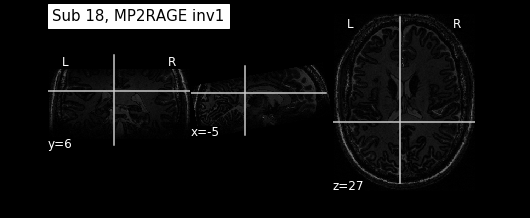

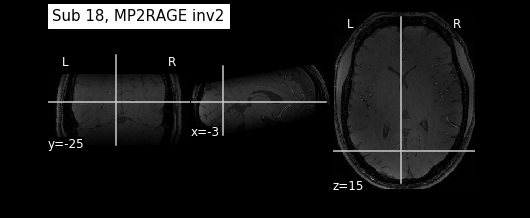

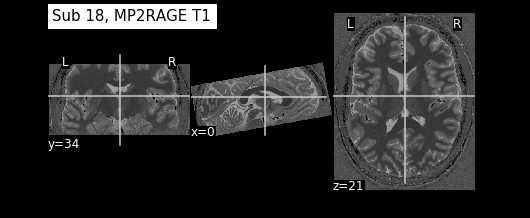

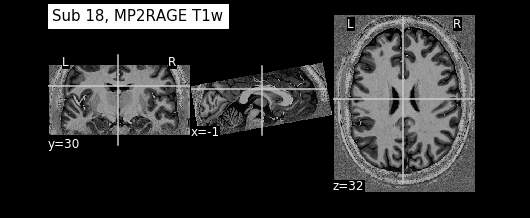

In [59]:
for subnum in np.arange(18, 19):
    leipzigcode = subnum2leipzig[str(subnum).zfill(2)]
    flash_imgs = glob('./data/raw/anat_session_nifti/%s_*/*FLASH_3D_3echos_*' %leipzigcode)
    flash_imgs.sort() ## Assume: flash images are always in the order of MAG-1, MAG-2, MAG-3; PH-1; PH-2; PH-3
    mprage_inv1 = glob('./data/raw/anat_session_nifti/%s_*/*mp2rage_slab_INV1*' %leipzigcode)[0]
    mprage_inv2 = glob('./data/raw/anat_session_nifti/%s_*/*mp2rage_slab_INV2*' %leipzigcode)[0]
    mprage_t1 = glob('./data/raw/anat_session_nifti/%s_*/*mp2rage_slab_T1*' %leipzigcode)[0]
    mprage_t1w = glob('./data/raw/anat_session_nifti/%s_*/*mp2rage_slab_UNI*' %leipzigcode)[0]

    plotting.plot_anat(mprage_inv1, title='Sub %s, MP2RAGE inv1'%subnum)
    plotting.plot_anat(mprage_inv2, title='Sub %s, MP2RAGE inv2'%subnum)
    plotting.plot_anat(mprage_t1, title='Sub %s, MP2RAGE T1'%subnum)
    plotting.plot_anat(mprage_t1w, title='Sub %s, MP2RAGE T1w'%subnum)
# subnum = 1
# scan_name = 'S3_FLASH_3D_3echos_Te11.22.nii.gz'
# template = glob('./data/raw/anat_session_nifti/%s_*/%s' %(subnum2leipzig[str(subnum).zfill(2)], scan_name))[0]


### Check if all FLASH images are complete & named correctly

/home/stevenm/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:518: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/home/stevenm/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:518: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/home/stevenm/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:518: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/home/stevenm/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:518: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/home/stevenm/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:518: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" %

/home/stevenm/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:518: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/home/stevenm/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:518: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/home/stevenm/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:518: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/home/stevenm/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:518: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/home/stevenm/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:518: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" %

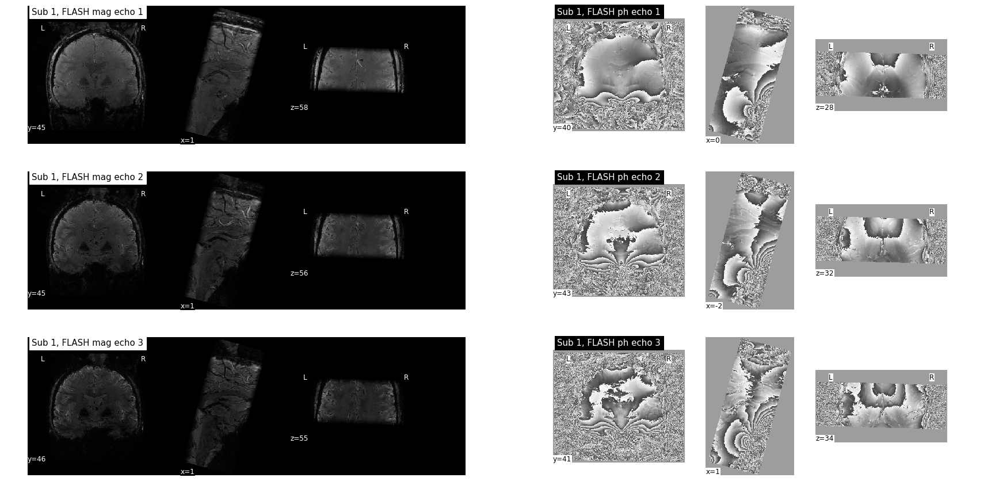

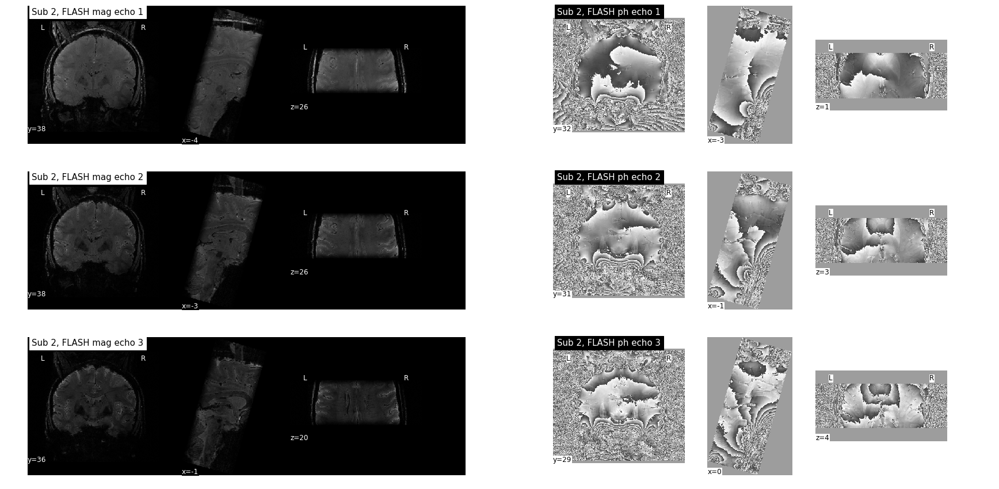

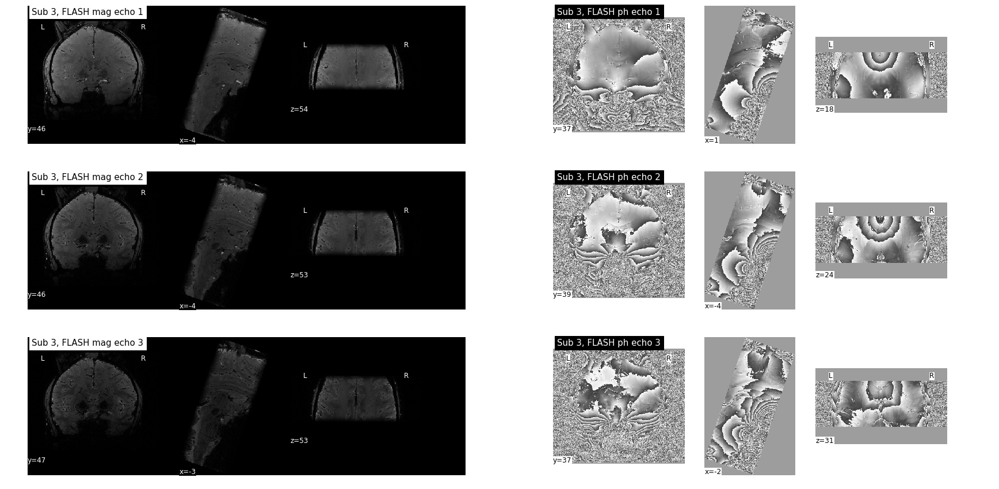

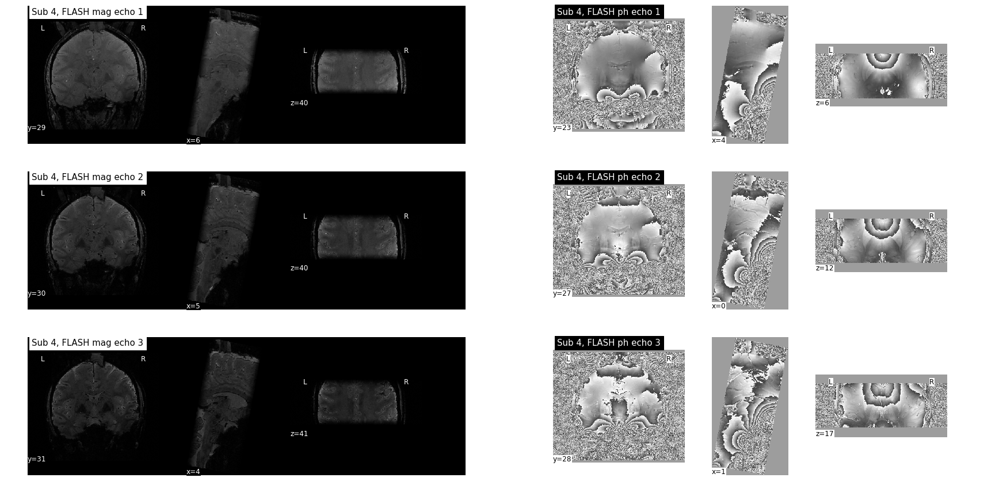

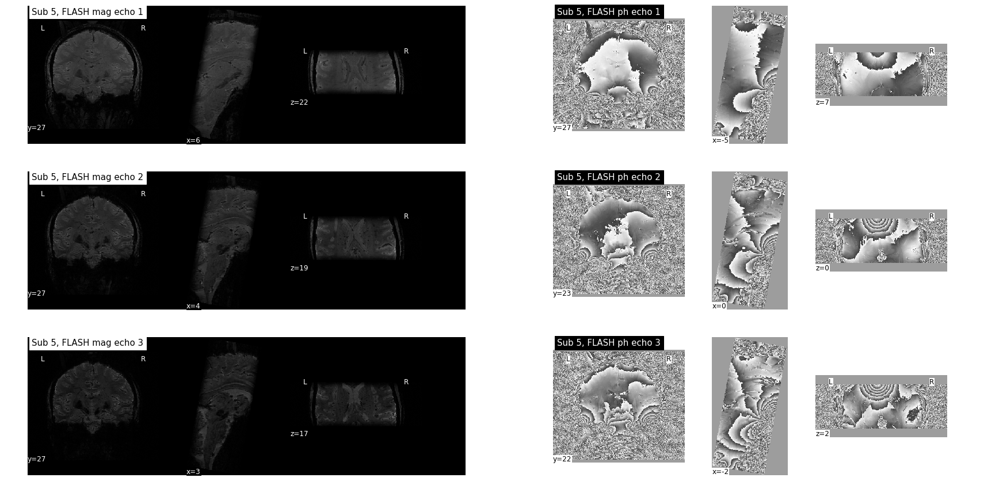

...

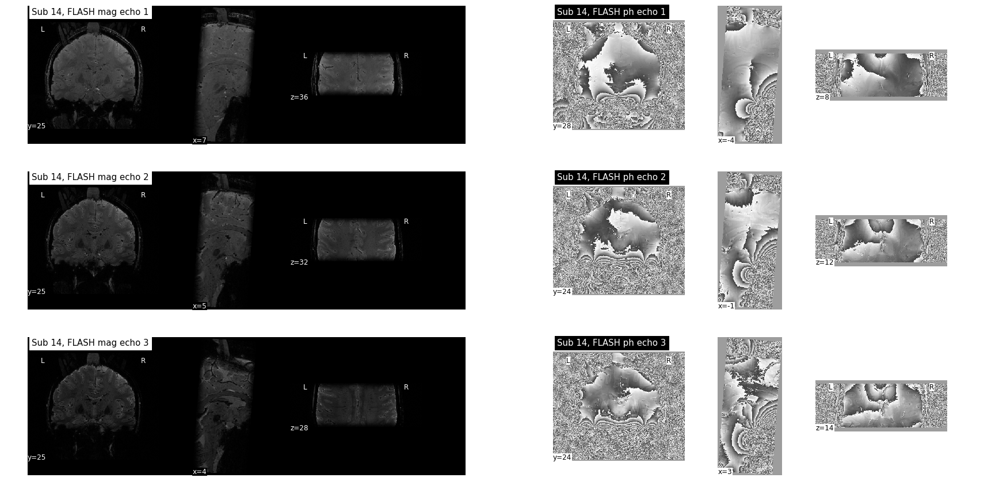

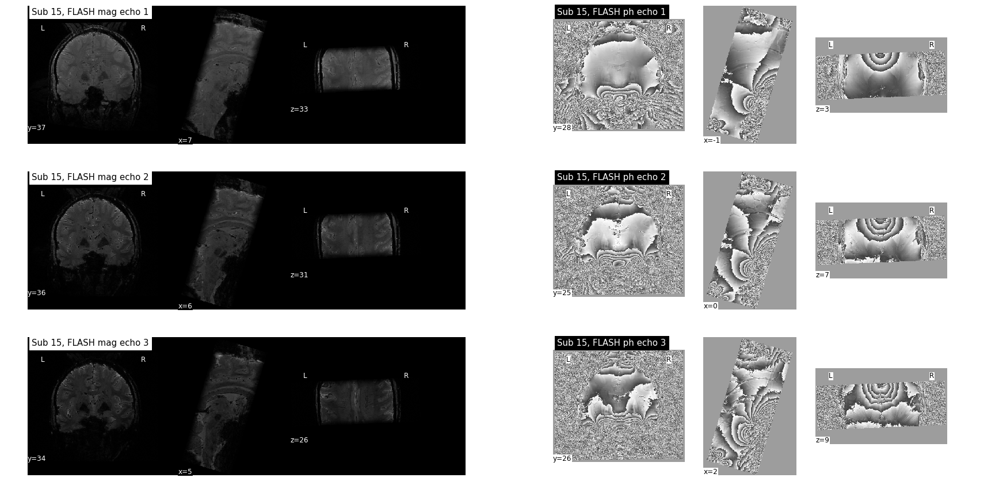

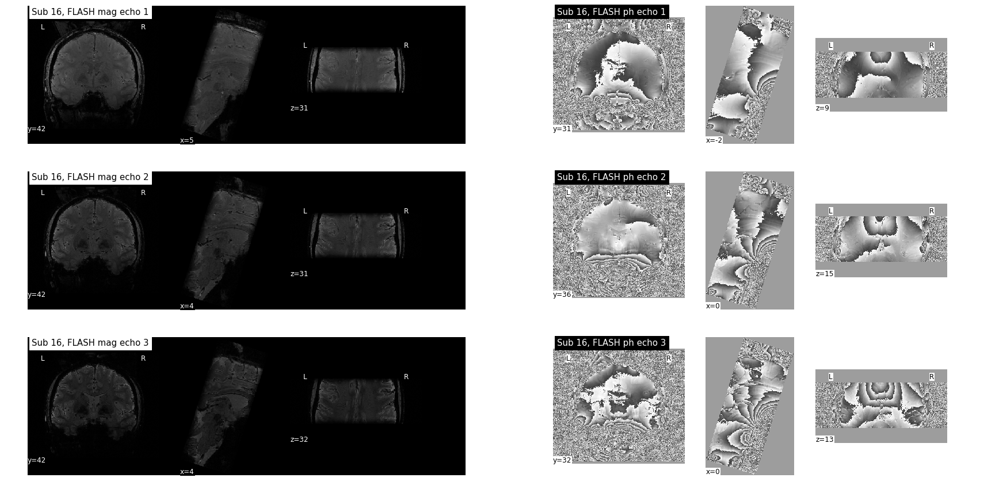

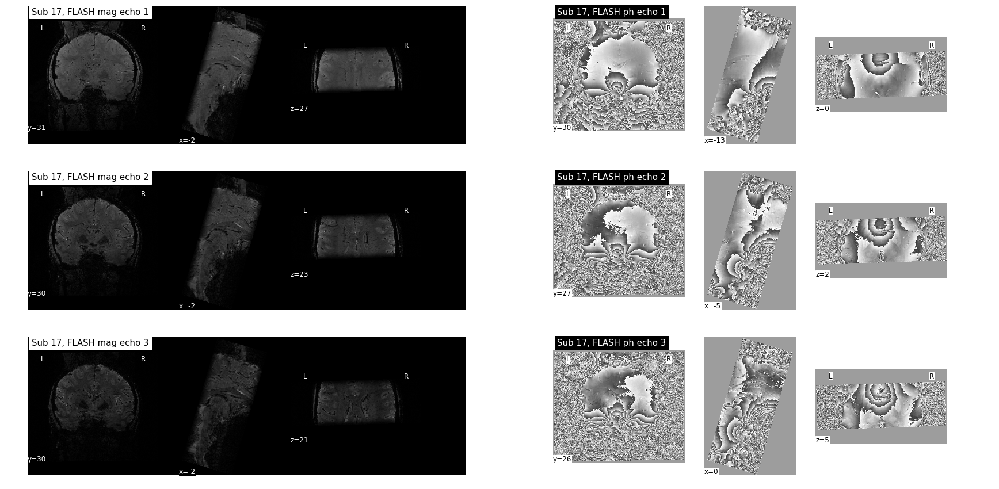

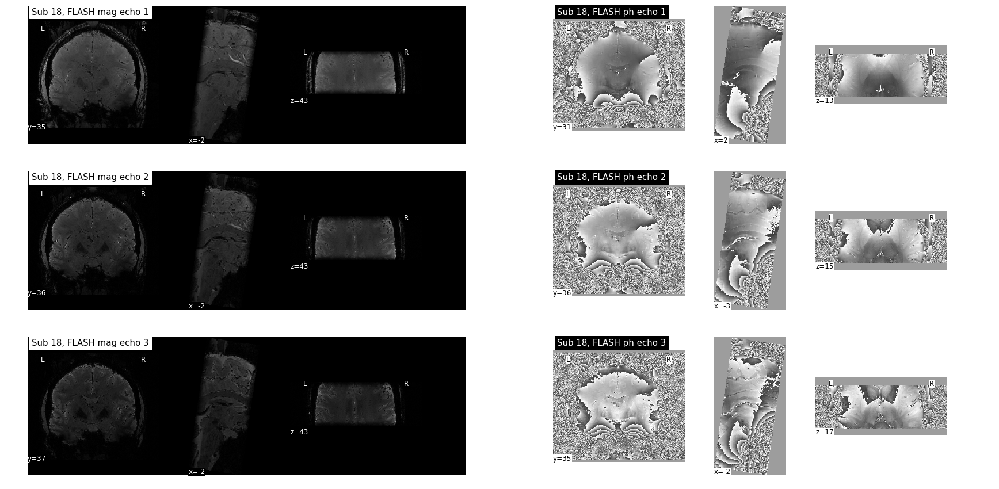

In [65]:
for subnum in np.arange(1, 19):
    leipzigcode = subnum2leipzig[str(subnum).zfill(2)]
    flash_imgs = glob('./data/raw/anat_session_nifti/%s_*/*FLASH_3D_3echos_*' %leipzigcode)
    
    flash_imgs.sort() ## Assume: flash images are always in the order of MAG-1, MAG-2, MAG-3; PH-1; PH-2; PH-3
    mprage_inv1 = glob('./data/raw/anat_session_nifti/%s_*/*mp2rage_slab_INV1*' %leipzigcode)[0]
    mprage_inv2 = glob('./data/raw/anat_session_nifti/%s_*/*mp2rage_slab_INV2*' %leipzigcode)[0]
    mprage_t1 = glob('./data/raw/anat_session_nifti/%s_*/*mp2rage_slab_T1*' %leipzigcode)[0]
    mprage_t1w = glob('./data/raw/anat_session_nifti/%s_*/*mp2rage_slab_UNI*' %leipzigcode)[0]
    
    f, ax = plt.subplots(3,2)

    plotting.plot_anat(flash_imgs[0], title='Sub %s, FLASH mag echo 1'%subnum, axes=ax[0,0], draw_cross=False)
    plotting.plot_anat(flash_imgs[1], title='Sub %s, FLASH mag echo 2'%subnum, axes=ax[1,0], draw_cross=False)
    plotting.plot_anat(flash_imgs[2], title='Sub %s, FLASH mag echo 3'%subnum, axes=ax[2,0], draw_cross=False)
    plotting.plot_anat(flash_imgs[3], title='Sub %s, FLASH ph echo 1'%subnum, axes=ax[0,1], draw_cross=False)
    plotting.plot_anat(flash_imgs[4], title='Sub %s, FLASH ph echo 2'%subnum, axes=ax[1,1], draw_cross=False)
    plotting.plot_anat(flash_imgs[5], title='Sub %s, FLASH ph echo 3'%subnum, axes=ax[2,1], draw_cross=False)
    
    
    f.set_size_inches(30,15)
#    f.show()
# subnum = 1
# scan_name = 'S3_FLASH_3D_3echos_Te11.22.nii.gz'
# template = glob('./data/raw/anat_session_nifti/%s_*/%s' %(subnum2leipzig[str(subnum).zfill(2)], scan_name))[0]


In [4]:
!ls ./data/raw/bids/sub-01/ses-me/anat

sub-01_ses-me_inv-1_MPRAGE.json
sub-01_ses-me_inv-1_MPRAGE.nii
sub-01_ses-me_inv-2_MPRAGE.json
sub-01_ses-me_inv-2_MPRAGE.nii
sub-01_ses-me_inv-2_MPRAGE_strip-inv2.nii
sub-01_ses-me_inv-2_MPRAGE_strip-inv2.nii.gz
sub-01_ses-me_inv-2_MPRAGE_strip-mask.nii
sub-01_ses-me_inv-2_MPRAGE_strip-mask.nii.gz
sub-01_ses-me_T1map.json
sub-01_ses-me_T1map.nii
sub-01_ses-me_T1map_strip-t1map.nii
sub-01_ses-me_T1map_strip-t1map.nii.gz
sub-01_ses-me_T1w.json
sub-01_ses-me_T1w.nii
sub-01_ses-me_T1w_strip-t1w.nii
sub-01_ses-me_T1w_strip-t1w.nii.gz
sub-01_ses-me_T1w_tmp_srccoord.nii.gz
sub-01_ses-me_T1w_tmp_trgcoord.nii.gz


# All seems correct, so let's convert to BIDS-format

Template from BIDS extention protocol 1 (https://docs.google.com/document/d/1QwfHyBzOyFWOLO4u_kkojLpUhW0-4_M7Ubafu9Gf4Gg/edit#):

`sub-<participant_label>/[ses-<session_label>/]anat/sub-<participant_label>[_ses-<session_label>][_acq-<label>][_rec-<label>][_fa-<index>][_inv-<index>][_echo-<index>][_part-<phase|mag>][_run-<index>]_<sequence_label>.nii[.gz]`

so, for FLASH:

- `sub-<participant_label>_ses-anat_echo-<echo_n>_part-<phase|mag>_FLASH.nii.gz`

and for MPRAGE include slab to be able to disentangle these from the whole-brain acquisitions

- `sub-<participant_label>_ses-anat_acq-slab_inv-<1|2>_MPRAGE.nii.gz`
- `sub-<participant_label>_ses-anat_acq-slab_T1map.nii.gz`
- `sub-<participant_label>_ses-anat_acq-slab_T1w.nii.gz`

In [10]:
output_dir = './data/raw/bids'

In [11]:
json_template_general = {'Modality': 'MR',
                         'MagneticFieldStrength': 6.98,
                         'Manufacturer': 'Siemens',
                         'ManufacturersModelName': 'Investigational_Device_7T',
                         'InstitutionName': 'MPI_Leipzig',
                         'InstitutionalDepartmentName': 'Department',
                         'InstitutionAddress': 'Stephanstrasse_1a_Leipzig-FCAF96-_Leipzig_DE_04103',
                         'DeviceSerialNumber': '18919',
                         'StationName': 'SEPTEMSYS'}
def make_json_sidecar_FLASH(echo_time, templ=json_template_general):
    templ['EchoTime'] = echo_time
    return templ

def make_json_sidecar_t1w_t1map(sub):
    if not isinstance(sub, str):
        sub = str(sub).zfill(2)
    out_dict = {'BasedOn': ['sub-{}_ses-anat_acq-slab_inv-1_MPRAGE.nii'.format(sub),
                            'sub-{}_ses-anat_acq-slab_inv-2_MPRAGE.nii'.format(sub)],
                'EstimationMethod': 'Marques et al., 2013'}
    return out_dict

#make_json_sidecar_t1w_t1map(2)

In [12]:
for sub in range(1, 19):
    sub_str = str(sub).zfill(2)
    leipzig_code = subnum2leipzig[sub_str]
    save_dir = os.path.join(output_dir, 'sub-%s'%sub_str, 'ses-anat', 'anat')
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    
    # get all FLASH images
    flash_imgs = glob('./data/raw/anat_session_nifti/%s_*/*FLASH_3D_3echos_*' %leipzig_code)
    flash_imgs.sort() ## Assume: flash images are always in the order of MAG-1, MAG-2, MAG-3; PH-1; PH-2; PH-3
    # and corresponding output names
    flash_output_names = [
        os.path.join(save_dir, 'sub-%s_ses-anat_echo-1_part-mag_FLASH.nii.gz'%sub_str),
        os.path.join(save_dir, 'sub-%s_ses-anat_echo-2_part-mag_FLASH.nii.gz'%sub_str),
        os.path.join(save_dir, 'sub-%s_ses-anat_echo-3_part-mag_FLASH.nii.gz'%sub_str),
        os.path.join(save_dir, 'sub-%s_ses-anat_echo-1_part-phase_FLASH.nii.gz'%sub_str),
        os.path.join(save_dir, 'sub-%s_ses-anat_echo-2_part-phase_FLASH.nii.gz'%sub_str),
        os.path.join(save_dir, 'sub-%s_ses-anat_echo-3_part-phase_FLASH.nii.gz'%sub_str),
    ]
    for img, path in zip(flash_imgs, flash_output_names):
        print('Copying {} to {}'.format(img, path))
        shutil.copy(img, path)
       
    # MP2RAGE images
    mprage_imgs = [
        glob('./data/raw/anat_session_nifti/%s_*/*mp2rage_slab_INV1*' %leipzig_code)[0],
        glob('./data/raw/anat_session_nifti/%s_*/*mp2rage_slab_INV2*' %leipzig_code)[0],
        glob('./data/raw/anat_session_nifti/%s_*/*mp2rage_slab_T1*' %leipzig_code)[0],
        glob('./data/raw/anat_session_nifti/%s_*/*mp2rage_slab_UNI*' %leipzig_code)[0]
    ]
    # and output names
    mprage_output_names = [
        os.path.join(save_dir, 'sub-%s_ses-anat_acq-slab_inv-1_MPRAGE.nii.gz'%sub_str),
        os.path.join(save_dir, 'sub-%s_ses-anat_acq-slab_inv-2_MPRAGE.nii.gz'%sub_str),
        os.path.join(save_dir, 'sub-%s_ses-anat_acq-slab_T1map.nii.gz'%sub_str),
        os.path.join(save_dir, 'sub-%s_ses-anat_acq-slab_T1w.nii.gz'%sub_str)        
    ]
    for img, path in zip(mprage_imgs,mprage_output_names):
        print('Copying {} to {}'.format(img, path))
        shutil.copy(img, path)
    
    # JSON sidecars
    for fn in flash_output_names:
        json_fn = fn.replace('.nii.gz', '.json')
        if 'echo-1' in fn:
            sidecar = make_json_sidecar_FLASH(echo_time=11.22/1e3)
        elif 'echo-2' in fn:
            sidecar = make_json_sidecar_FLASH(echo_time=20.39/1e3)
        elif 'echo-3' in fn:
            sidecar = make_json_sidecar_FLASH(echo_time=29.57/1e3)
        with open(json_fn, 'w') as f:
            json.dump(sidecar, f)
    
    sidecar_mprage_derivatives = make_json_sidecar_t1w_t1map(sub)
    with open(mprage_output_names[2].replace('.nii.gz', '.json'), 'w') as f:
        json.dump(sidecar_mprage_derivatives, f)
    with open(mprage_output_names[3].replace('.nii.gz', '.json'), 'w') as f:
        json.dump(sidecar_mprage_derivatives, f)
    
    sidecar_mprage_invs = json_template_general
    with open(mprage_output_names[0].replace('.nii.gz', '.json'), 'w') as f:
        json.dump(sidecar_mprage_invs, f)
    with open(mprage_output_names[1].replace('.nii.gz', '.json'), 'w') as f:
        json.dump(sidecar_mprage_invs, f)

Copying ./data/raw/anat_session_nifti/26824.0f_181026_111138/S2_FLASH_3D_3echos_Te11.22.nii.gz to ./data/raw/bids/sub-01/ses-anat/anat/sub-01_ses-anat_echo-1_part-mag_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/26824.0f_181026_111138/S2_FLASH_3D_3echos_Te20.39.nii.gz to ./data/raw/bids/sub-01/ses-anat/anat/sub-01_ses-anat_echo-2_part-mag_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/26824.0f_181026_111138/S2_FLASH_3D_3echos_Te29.57.nii.gz to ./data/raw/bids/sub-01/ses-anat/anat/sub-01_ses-anat_echo-3_part-mag_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/26824.0f_181026_111138/S3_FLASH_3D_3echos_Te11.22.nii.gz to ./data/raw/bids/sub-01/ses-anat/anat/sub-01_ses-anat_echo-1_part-phase_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/26824.0f_181026_111138/S3_FLASH_3D_3echos_Te20.39.nii.gz to ./data/raw/bids/sub-01/ses-anat/anat/sub-01_ses-anat_echo-2_part-phase_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/26824.0f_181026_111138/S3_FLASH_3D_3echos_Te29.57.nii.gz t

Copying ./data/raw/anat_session_nifti/32389.13_181024_074714/S5_mp2rage_slab_T1_Images_Te3.71.nii.gz to ./data/raw/bids/sub-05/ses-anat/anat/sub-05_ses-anat_acq-slab_T1map.nii.gz
Copying ./data/raw/anat_session_nifti/32389.13_181024_074714/S6_mp2rage_slab_UNI_Images_Te3.71.nii.gz to ./data/raw/bids/sub-05/ses-anat/anat/sub-05_ses-anat_acq-slab_T1w.nii.gz
Copying ./data/raw/anat_session_nifti/26153.41_181005_125716/S2_FLASH_3D_3echos_Te11.22.nii.gz to ./data/raw/bids/sub-06/ses-anat/anat/sub-06_ses-anat_echo-1_part-mag_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/26153.41_181005_125716/S2_FLASH_3D_3echos_Te20.39.nii.gz to ./data/raw/bids/sub-06/ses-anat/anat/sub-06_ses-anat_echo-2_part-mag_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/26153.41_181005_125716/S2_FLASH_3D_3echos_Te29.57.nii.gz to ./data/raw/bids/sub-06/ses-anat/anat/sub-06_ses-anat_echo-3_part-mag_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/26153.41_181005_125716/S3_FLASH_3D_3echos_Te11.22.nii.gz to ./dat

Copying ./data/raw/anat_session_nifti/19717.75_181008_074232/S3_FLASH_3D_3echos_Te20.39.nii.gz to ./data/raw/bids/sub-10/ses-anat/anat/sub-10_ses-anat_echo-2_part-phase_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/19717.75_181008_074232/S3_FLASH_3D_3echos_Te29.57.nii.gz to ./data/raw/bids/sub-10/ses-anat/anat/sub-10_ses-anat_echo-3_part-phase_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/19717.75_181008_074232/S4_mp2rage_slab_INV1_Te3.71.nii.gz to ./data/raw/bids/sub-10/ses-anat/anat/sub-10_ses-anat_acq-slab_inv-1_MPRAGE.nii.gz
Copying ./data/raw/anat_session_nifti/19717.75_181008_074232/S5_mp2rage_slab_INV2_Te3.71.nii.gz to ./data/raw/bids/sub-10/ses-anat/anat/sub-10_ses-anat_acq-slab_inv-2_MPRAGE.nii.gz
Copying ./data/raw/anat_session_nifti/19717.75_181008_074232/S6_mp2rage_slab_T1_Images_Te3.71.nii.gz to ./data/raw/bids/sub-10/ses-anat/anat/sub-10_ses-anat_acq-slab_T1map.nii.gz
Copying ./data/raw/anat_session_nifti/19717.75_181008_074232/S7_mp2rage_slab_UNI_Images_Te3.71.

Copying ./data/raw/anat_session_nifti/15484.08_181019_114712/S7_mp2rage_slab_UNI_Images_Te3.71.nii.gz to ./data/raw/bids/sub-15/ses-anat/anat/sub-15_ses-anat_acq-slab_T1w.nii.gz
Copying ./data/raw/anat_session_nifti/29121.94_181024_151219/S2_FLASH_3D_3echos_Te11.22.nii.gz to ./data/raw/bids/sub-16/ses-anat/anat/sub-16_ses-anat_echo-1_part-mag_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/29121.94_181024_151219/S2_FLASH_3D_3echos_Te20.39.nii.gz to ./data/raw/bids/sub-16/ses-anat/anat/sub-16_ses-anat_echo-2_part-mag_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/29121.94_181024_151219/S2_FLASH_3D_3echos_Te29.57.nii.gz to ./data/raw/bids/sub-16/ses-anat/anat/sub-16_ses-anat_echo-3_part-mag_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/29121.94_181024_151219/S3_FLASH_3D_3echos_Te11.22.nii.gz to ./data/raw/bids/sub-16/ses-anat/anat/sub-16_ses-anat_echo-1_part-phase_FLASH.nii.gz
Copying ./data/raw/anat_session_nifti/29121.94_181024_151219/S3_FLASH_3D_3echos_Te20.39.nii.gz to ./